# EDA for Anime Recommender System

In this notebook We are going to show some exploration data, cleaning some features and structure our final dataset. 

In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
import time

We have 2 datasets from kaggle, if you want to download you can follow the next link: https://www.kaggle.com/CooperUnion/anime-recommendations-database

In [2]:
#Reading data
df_anime=pd.read_csv('anime.csv')
df_rating=pd.read_csv('rating.csv')

In [3]:
df_anime.head()

,anime_id,name,genre,type,episodes,rating,members
0,32281,Kimi no Na wa.,"Drama, Romance, School, Supernatural",Movie,1,9.37,200630
1,5114,Fullmetal Alchemist: Brotherhood,"Action, Adventure, Drama, Fantasy, Magic, Mili...",TV,64,9.26,793665
2,28977,Gintama°,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.25,114262
3,9253,Steins;Gate,"Sci-Fi, Thriller",TV,24,9.17,673572
4,9969,Gintama&#039;,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.16,151266


As you can see above, the dataset contain a set of animes with his respective genres, type, number of episodes, average rating and number of members which follow that anime.

In [4]:
df_rating.head()

,user_id,anime_id,rating
0,1,20,-1
1,1,24,-1
2,1,79,-1
3,1,226,-1
4,1,241,-1


On the other dataset, this is about a specific user give a rating to specific anime, the rating is between 1 to 10. if rating is -1 that is mean that user did not rate the anime.

In [5]:
df_anime.describe()

,anime_id,rating,members
count,12294.000000,12064.000000,1.229400e+04
mean,14058.221653,6.473902,1.807134e+04
std,11455.294701,1.026746,5.482068e+04
min,1.000000,1.670000,5.000000e+00
25%,3484.250000,5.880000,2.250000e+02
50%,10260.500000,6.570000,1.550000e+03
75%,24794.500000,7.180000,9.437000e+03
max,34527.000000,10.000000,1.013917e+06


In [6]:
df_anime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12294 entries, 0 to 12293
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   anime_id  12294 non-null  int64  
 1   name      12294 non-null  object 
 2   genre     12232 non-null  object 
 3   type      12269 non-null  object 
 4   episodes  12294 non-null  object 
 5   rating    12064 non-null  float64
 6   members   12294 non-null  int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 672.5+ KB


If you see the plot below, the rating has a skewed distribution with trend in more positive ratings than negative ones

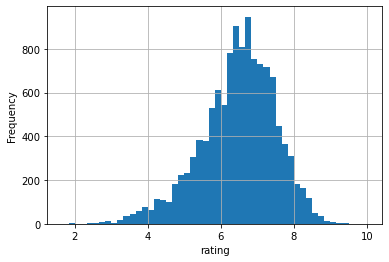

In [7]:
plt.xlabel("rating")
plt.ylabel("Frequency")
df_anime.rating.hist(bins=50)
plt.show()

most of the animes have a small group of members, probably the most famous animes have a lot more

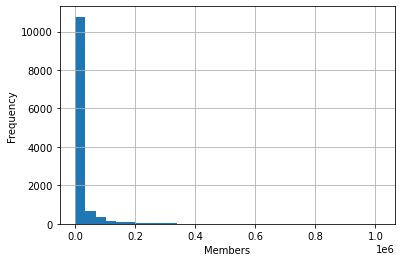

In [8]:
plt.xlabel("Members")
plt.ylabel("Frequency")
df_anime.members.hist(bins=30)
plt.show()

Here we can see the frecuency of each number of episode. In this case, most of the animes have 1 episode then 2 and followed vy 12. This have sense considering we have not only tv program but also movies (likely is 1), and also you have specials, OVAS, ONAS. We can consider special programs which not necessarily follow the main program (a Tv type), so you can see a lot of programs with just 1 episode. Other thing to consider is that we have a considerable amount of series with "unknown" number of episodes.

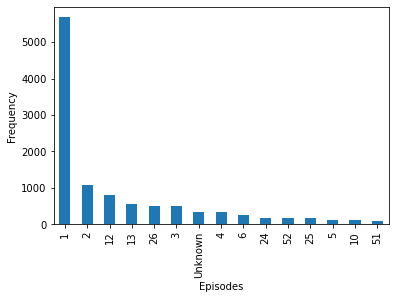

In [9]:
plt.xlabel("Episodes")
plt.ylabel("Frequency")
df_anime.episodes.value_counts().head(15).plot.bar()
plt.show()

We have more TV programs and also OVAs and movies

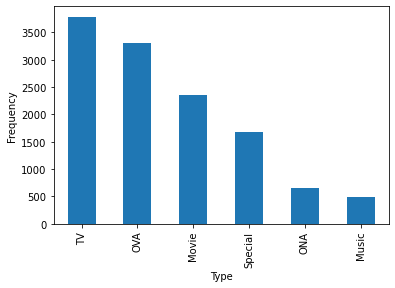

In [10]:
plt.xlabel("Type")
plt.ylabel("Frequency")
df_anime.type.value_counts().plot.bar()
plt.show()

In the plot below We can see top 10 animes by rating, this top 10 is not necessary the most popular because we should consider if only one person positively rated an anime, this one can lead the rank. However this rank is not pretty bad at all, seeing famous animations like Kimi no Na wa, Gintama or Steins Gat, is a good feature to consider. 

<AxesSubplot:xlabel='name'>

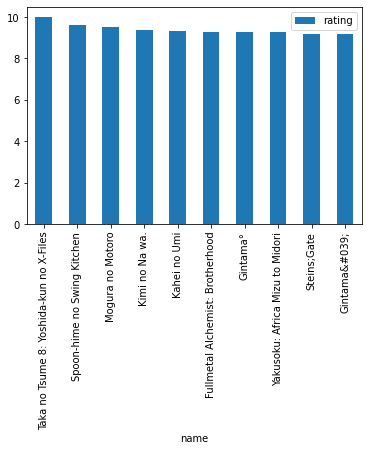

In [11]:
#Top 10 Animes Rating counts
df_anime.sort_values(by='rating', ascending=False )[['name','rating']].head(10).plot.bar(x='name')

This variable is more representative about the more famous animes, all these series were trends in their respective seasons and continue being "a must" to watch.

<AxesSubplot:xlabel='name'>

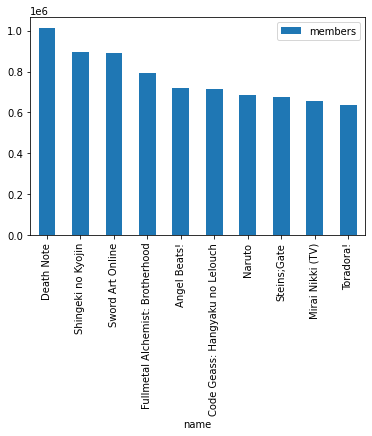

In [12]:
#Top 10 based on number of members
df_anime.sort_values(by='members', ascending=False )[['name','members']].head(10).plot.bar(x='name')

The scatter plot below show the relation between number of members and rating, this is an interesting plot and you can see the more members the anime have, the better rating can get from his fans. And if we think about it, has all the sense. If an anime begins to gain followers and its community is large, the main idea is that the show is at least decent. But note that many of those evaluated with the highest points have few members as well, as explained above, particular niche anime may have a more significant impact among their members.

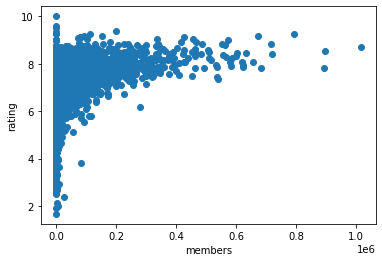

In [13]:
#Relation between number of members and rating
plt.xlabel("members")
plt.ylabel("rating")
plt.scatter(x=df_anime.members, y=df_anime.rating)
plt.show()

In general, as you can see, the vast majority of animes are less than 250 episodes, they will be the shortest ones that have a greater probability of receiving a very bad score, while those with more episodes have a rating that is close to the average. So there is no certainty that these series are the most popular.

In [14]:
#Replace "unknown" with 1 (the mode)
df_anime['episodes']=df_anime['episodes'].replace(  {"Unknown":'1'})
df_anime['episodes']=df_anime['episodes'].astype(str).astype(int)

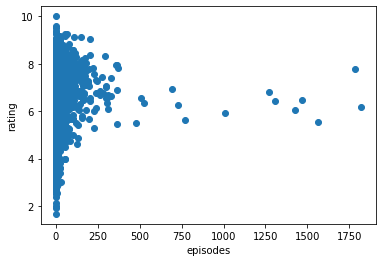

In [15]:
#Relation between number of episodes and rating


plt.xlabel("episodes")
plt.ylabel("rating")
plt.scatter(x=df_anime.episodes, y=df_anime.rating)
plt.show()

In [16]:
#Checking nulls
null_features = df_anime.columns[df_anime.isna().any()]
df_anime[null_features].isna().sum()

genre      62
type       25
rating    230
dtype: int64

<AxesSubplot:>

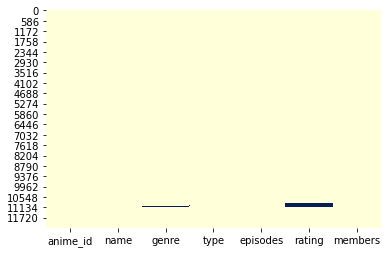

In [17]:
sns.heatmap(df_anime.isnull(), cbar=False, cmap="YlGnBu")

When we see the series that we have the presence of missing values, we can notice that the offer is very varied, having series that were very popular such as Shingeki no Kyojin Season 2 to others much less known so it is more difficult to estimate a possible rating.

In [18]:
#Anime rating with nan to list
df_anime[df_anime.rating.isna()]['name'].tolist()

['Inazma Delivery',
 'Nananin no Ayakashi: Chimi Chimi Mouryou!! Gendai Monogatari',
 'Gintama (2017)',
 'One Punch Man 2',
 'Steins;Gate 0',
 'Shingeki no Kyojin Season 2',
 'Code Geass: Fukkatsu no Lelouch',
 'Boku no Hero Academia 2nd Season',
 'Kono Subarashii Sekai ni Shukufuku wo! 2',
 'Ao no Exorcist: Kyoto Fujouou-hen',
 'Super Lovers 2',
 'Saenai Heroine no Sodatekata ♭',
 'Violet Evergarden',
 'K: Seven Stories',
 'Sword Art Online Movie: Ordinal Scale',
 'Dungeon ni Deai wo Motomeru no wa Machigatteiru Darou ka Gaiden: Sword Oratoria',
 'Masamune-kun no Revenge',
 'Kantai Collection: KanColle Zoku-hen',
 'Fate/Extra Last Encore',
 'Yowamushi Pedal: New Generation',
 'Kekkai Sensen &amp; Beyond',
 'Mekakucity Reload',
 'Fate/stay night Movie: Heaven&#039;s Feel',
 'Fuuka',
 'Free! (Shinsaku)',
 'No Game No Life Movie',
 'Little Witch Academia (TV)',
 'Kuzu no Honkai',
 'ChäoS;Child',
 'Eromanga-sensei',
 'Berserk (2017)',
 'Hand Shakers',
 'Zero kara Hajimeru Mahou no Sho',
 

In [19]:
#Filling missing values for genre and type we use the mode, for rating we use the median
df_anime['genre']=df_anime['genre'].fillna(df_anime['genre'].mode()[0])

df_anime['type']=df_anime['type'].fillna(df_anime['type'].mode()[0])

df_anime.rating=df_anime.rating.fillna(df_anime.rating.median())

In [20]:
df_rating.describe()

,user_id,anime_id,rating
count,7.813737e+06,7.813737e+06,7.813737e+06
mean,3.672796e+04,8.909072e+03,6.144030e+00
std,2.099795e+04,8.883950e+03,3.727800e+00
min,1.000000e+00,1.000000e+00,-1.000000e+00
25%,1.897400e+04,1.240000e+03,6.000000e+00
50%,3.679100e+04,6.213000e+03,7.000000e+00
75%,5.475700e+04,1.409300e+04,9.000000e+00
max,7.351600e+04,3.451900e+04,1.000000e+01


Now we review the rating dataset. The histogram below shows that the higher the rating, the more people left that vote for a specific anime. This may be because people who have enjoyed a series or movie with tremendous enthusiasm have left a positive review. Many more people decided to see the popular series in the community and give their opinion. But we also have a large number of people who chose not to vote. Among the possibilities are that people did not create an account in myanimelist (which is unlikely in my opinion); another is that they decide to place that they saw the series. Still, they didn't finish them (which means it may be negative feedback) or don't like adding feedback. There are several options, but finally, given the number of possibilities for a quick approach, it is decided not to consider those rating -1

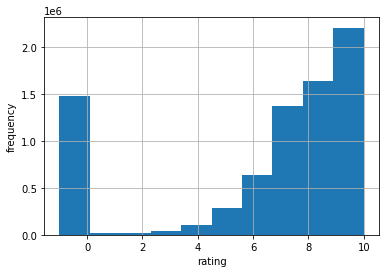

In [21]:
plt.xlabel("rating")
plt.ylabel("frequency")
df_rating.rating.hist(bins=10)
plt.show()

Here we can see a long tail effect but only with one user, which is quite curious, since many times it is a small group of people who generate the most votes and then a drop in participation is generated by the rest of the users

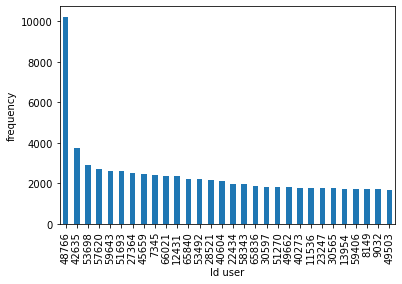

In [22]:
plt.xlabel("Id user")
plt.ylabel("frequency")
df_rating.user_id.value_counts().head(30).plot.bar()
plt.show()

On the other hand, when viewing the animes that are being evaluated by users, the long tail effect is less noticeable since the difference between the first and the second is much smaller.

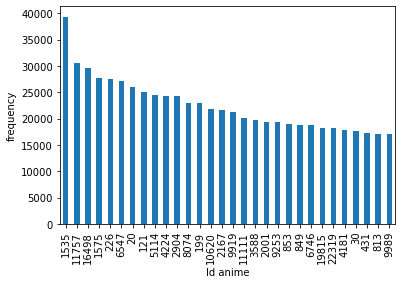

In [23]:
plt.xlabel("Id anime")
plt.ylabel("frequency")
df_rating.anime_id.value_counts().head(30).plot.bar()
plt.show()

In [24]:
df_anime.sort_values(by='rating', ascending=False )['name'].head(2).tolist()

['Taka no Tsume 8: Yoshida-kun no X-Files', 'Spoon-hime no Swing Kitchen']

In [25]:
#Get top anime by rating in a list
def get_top_anime(n,df=df_anime):
    
    '''
    INPUT:
    n - (int) the number of top articles to return
    df - (pandas dataframe) df as dataset related to anime list  

    OUTPUT:
    top_articles - (list) A list of the top 'n' article titles

    '''
    top_anime_list= df.sort_values(by='rating', ascending=False )['name'].head(n).tolist()
    return top_anime_list

In [26]:
#Quizas considerar la función para que retorne un top pero de una categoría o tipo
#También podemos crear un test
print(get_top_anime(10))

['Taka no Tsume 8: Yoshida-kun no X-Files', 'Spoon-hime no Swing Kitchen', 'Mogura no Motoro', 'Kimi no Na wa.', 'Kahei no Umi', 'Fullmetal Alchemist: Brotherhood', 'Yakusoku: Africa Mizu to Midori', 'Gintama°', 'Steins;Gate', 'Gintama&#039;']


In [27]:
#We are going to split the genre, at first we are going to delete white spaces and then build a function to use one hot encoding for this feature and concatenate the rest. 
df_anime['genre']=df_anime['genre'].replace(" ", "", regex=True)
df_anime.head()

,anime_id,name,genre,type,episodes,rating,members
0,32281,Kimi no Na wa.,"Drama,Romance,School,Supernatural",Movie,1,9.37,200630
1,5114,Fullmetal Alchemist: Brotherhood,"Action,Adventure,Drama,Fantasy,Magic,Military,...",TV,64,9.26,793665
2,28977,Gintama°,"Action,Comedy,Historical,Parody,Samurai,Sci-Fi...",TV,51,9.25,114262
3,9253,Steins;Gate,"Sci-Fi,Thriller",TV,24,9.17,673572
4,9969,Gintama&#039;,"Action,Comedy,Historical,Parody,Samurai,Sci-Fi...",TV,51,9.16,151266


In [28]:
#For genre and type we use one hot encoding the rest we keep the same values
def one_hot_encoding(df_anime):
    '''
    INPUT:

    df_anime - pandas dataframe with anime description

    '''
    anime_features = pd.concat([df_anime[["anime_id"]],
                                df_anime["genre"].str.get_dummies(sep=","),
                                pd.get_dummies(df_anime[["type"]]),
                                #df_anime[["type"]],
                                df_anime[["rating"]],
                                df_anime[["members"]],
                                df_anime["episodes"]],
                               axis=1)
    return anime_features

In [29]:
df_anime=one_hot_encoding(df_anime)

In [30]:
df_anime.head()

,anime_id,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,...,Yuri,type_Movie,type_Music,type_ONA,type_OVA,type_Special,type_TV,rating,members,episodes
0,32281,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,9.37,200630,1
1,5114,1,1,0,0,0,0,1,0,1,...,0,0,0,0,0,0,1,9.26,793665,64
2,28977,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,9.25,114262,51
3,9253,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,9.17,673572,24
4,9969,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,9.16,151266,51


In [31]:
df_anime.columns

Index(['anime_id', 'Action', 'Adventure', 'Cars', 'Comedy', 'Dementia',
       'Demons', 'Drama', 'Ecchi', 'Fantasy', 'Game', 'Harem', 'Hentai',
       'Historical', 'Horror', 'Josei', 'Kids', 'Magic', 'MartialArts',
       'Mecha', 'Military', 'Music', 'Mystery', 'Parody', 'Police',
       'Psychological', 'Romance', 'Samurai', 'School', 'Sci-Fi', 'Seinen',
       'Shoujo', 'ShoujoAi', 'Shounen', 'ShounenAi', 'SliceofLife', 'Space',
       'Sports', 'SuperPower', 'Supernatural', 'Thriller', 'Vampire', 'Yaoi',
       'Yuri', 'type_Movie', 'type_Music', 'type_ONA', 'type_OVA',
       'type_Special', 'type_TV', 'rating', 'members', 'episodes'],
      dtype='object')

In [32]:
#Transform the rating columns -1 to nan
df_rating['rating'] = df_rating['rating'].apply(lambda x: np.nan if x==-1 else x)
df_rating.head(20)

,user_id,anime_id,rating
0,1,20,NaN
1,1,24,NaN
2,1,79,NaN
3,1,226,NaN
4,1,241,NaN
5,1,355,NaN
6,1,356,NaN
7,1,442,NaN
8,1,487,NaN
9,1,846,NaN


In [33]:
#Delete nan
df_rating=df_rating.dropna(axis=0,how='any')

In [34]:
df_rating.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6337241 entries, 47 to 7813736
Data columns (total 3 columns):
 #   Column    Dtype  
---  ------    -----  
 0   user_id   int64  
 1   anime_id  int64  
 2   rating    float64
dtypes: float64(1), int64(2)
memory usage: 193.4 MB


In [35]:
#Finally we merge both datasets to build a new one.
merged_df = pd.merge(df_anime, df_rating,how="inner", on="anime_id")


In [36]:
merged_df.head(5)

,anime_id,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,...,type_Music,type_ONA,type_OVA,type_Special,type_TV,rating_x,members,episodes,user_id,rating_y
0,32281,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,9.37,200630,1,99,5.0
1,32281,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,9.37,200630,1,152,10.0
2,32281,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,9.37,200630,1,244,10.0
3,32281,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,9.37,200630,1,271,10.0
4,32281,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,9.37,200630,1,322,10.0


In [37]:
merged_df.episodes.describe()

count    6.337239e+06
mean     1.875248e+01
std      3.520915e+01
min      1.000000e+00
25%      3.000000e+00
50%      1.200000e+01
75%      2.400000e+01
max      1.818000e+03
Name: episodes, dtype: float64

In [38]:
merged_df['episodes'].unique()

array([   1,   64,   51,   24,   10,  148,  110,   13,  201,   25,   22,
         75,    4,   26,   12,   27,   43,   74,   37,    2,   11,   99,
         39,  101,   47,   50,   62,   33,  112,   23,    3,   94,    8,
         14,    7,   40,   15,  203,   77,  291,    6,  102,   96,   38,
         79,  175,  103,   70,  153,   45,    5,   21,   63,   52,   28,
        145,   36,   69,   60,  178,  114,   35,   61,   34,  109,   20,
          9,   49,  366,   97,   48,   78,  358,  155,  104,  113,   54,
        167,  161,   42,  142,   31,  373,  220,   46,  195,   17, 1787,
         73,  147,  127,   16,   19,   98,  150,   76,   53,  124,   29,
        115,  224,   44,   58,   93,  154,   92,   67,  172,   86,   30,
        276,   59,   72,  330,   41,  105,  128,  137,   56,   55,   65,
        243,  193,   18,  191,  180,   91,  192,   66,  182,   32,  164,
        100,  296,  694,   95,   68,  117,  151,  130,   87,  170,  119,
         84,  108,  156,  140,  331,  305,  300,  5

In [39]:
#We delete the anime id to refer only by his characteristics
#merged_df=merged_df.drop( ['anime_id'], axis=1)
merged_df.columns

Index(['anime_id', 'Action', 'Adventure', 'Cars', 'Comedy', 'Dementia',
       'Demons', 'Drama', 'Ecchi', 'Fantasy', 'Game', 'Harem', 'Hentai',
       'Historical', 'Horror', 'Josei', 'Kids', 'Magic', 'MartialArts',
       'Mecha', 'Military', 'Music', 'Mystery', 'Parody', 'Police',
       'Psychological', 'Romance', 'Samurai', 'School', 'Sci-Fi', 'Seinen',
       'Shoujo', 'ShoujoAi', 'Shounen', 'ShounenAi', 'SliceofLife', 'Space',
       'Sports', 'SuperPower', 'Supernatural', 'Thriller', 'Vampire', 'Yaoi',
       'Yuri', 'type_Movie', 'type_Music', 'type_ONA', 'type_OVA',
       'type_Special', 'type_TV', 'rating_x', 'members', 'episodes', 'user_id',
       'rating_y'],
      dtype='object')

In [155]:
#Split the data in relation 90/10
X_train, X_test, y_train, y_test = train_test_split(merged_df,
                                                    merged_df["rating_y"],
                                                    test_size=0.1,
                                                    # we are setting the seed here:
                                                    random_state=42)  

In [156]:
#And we save it
X_train.to_csv(r'data/train4.csv' , index=False)
X_test.to_csv(r'data/test4.csv', index=False)

In [177]:

X_train= pd.read_csv(r'data/train.csv')
X_test= pd.read_csv(r'data/test.csv')
#X_test.head()

In [157]:
X_train=X_train.drop('rating_y',axis=1)
X_test=X_test.drop('rating_y',axis=1)

In [158]:
final_features=X_train.columns
X_train.head()

,anime_id,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,...,type_Movie,type_Music,type_ONA,type_OVA,type_Special,type_TV,rating_x,members,episodes,user_id
1354863,437,0,0,0,0,1,0,1,0,0,...,1,0,0,0,0,0,8.23,117565,1,28669
69813,4181,0,0,0,0,0,0,1,0,1,...,0,0,0,0,0,1,9.06,456749,24,52535
1678097,10080,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,1,8.12,194300,12,48664
5848134,9936,1,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,6.69,104182,12,32860
938819,329,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,8.38,105044,26,46146


In [159]:
#data_fold=pd.read_csv(r'data/train_folds.csv')
#data_fold.head()

In [160]:
#data_fold.kfold.unique()

In [181]:
#Estandarización de los datos
scaler=StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)
#X_train

In [182]:
X_test

array([[-0.85165055, -0.52400848, -0.05193434, ..., -0.8233018 ,
        -0.50431488, -1.34037454],
       [-0.85165055, -0.52400848, -0.05193434, ...,  1.27810014,
        -0.13499714,  0.74082814],
       [-0.85165055, -0.52400848, -0.05193434, ..., -0.64763193,
        -0.1634062 , -1.25319378],
       ...,
       [ 1.17419052,  1.90836606, -0.05193434, ...,  1.85072692,
         0.14909343, -1.29411924],
       [ 1.17419052, -0.52400848, -0.05193434, ...,  0.73186208,
         0.14909343, -0.82875863],
       [-0.85165055, -0.52400848, -0.05193434, ..., -0.63953409,
        -0.50431488, -0.00648989]])

In [183]:
#Linear regression
start = time.time()
reg = LinearRegression().fit(X_train, y_train)
pred = reg.predict(X_train)
end = time.time()

In [184]:
print('train mse: {}'.format(
    mean_squared_error(y_train, pred)))
print('train rmse: {}'.format(
    np.sqrt(mean_squared_error(y_train, pred))))
print('train r2: {}'.format(
    r2_score(y_train, pred)))
print('time is: {} seconds or {} minutes'. format(round(
    end-start),round((end-start)/60)))
print()

train mse: 2.054612574187443
train rmse: 1.4333919820437964
train r2: 0.16911951415438464
time is: 26 seconds or 0 minutes



In [185]:
pred=reg.predict(X_test)

print('test mse: {}'.format(
    mean_squared_error(y_test, pred)))
print('test rmse: {}'.format(
    np.sqrt(mean_squared_error(y_test, pred))))
print('test r2: {}'.format(
    r2_score(y_test, pred)))
print()

test mse: 2.0520859091300987
test rmse: 1.4325103521895046
test r2: 0.16990600551655954



In [187]:
dt = DecisionTreeRegressor(random_state = 42,max_depth=30 )
scores = cross_val_score(dt, X_train, y_train, cv=5,scoring='neg_mean_squared_error')
print(scores)

[-2.60667271 -2.60407989 -2.62829348 -2.60474152 -2.60755075]


In [188]:
start = time.time()
dt = DecisionTreeRegressor(random_state = 42,max_depth=20)
dt.fit(X_train,y_train)
end = time.time()

In [189]:
pred=dt.predict(X_train)

In [190]:
print('train mse: {}'.format(
    mean_squared_error(y_train, pred)))
print('train rmse: {}'.format(
    np.sqrt(mean_squared_error(y_train, pred))))
print('train r2: {}'.format(
    r2_score(y_train, pred)))
print('time is: {} seconds or {} minutes'. format(round(
    end-start),round((end-start)/60)))
print()

train mse: 1.9147984753009974
train rmse: 1.3837624345605706
train r2: 0.22566000644489792
time is: 222 seconds or 4 minutes



In [191]:
pred = dt.predict(X_test)

print('test mse: {}'.format(int(
    mean_squared_error(y_test, pred))))
print('test rmse: {}'.format(int(
    np.sqrt(mean_squared_error(y_test, pred)))))
print('test r2: {}'.format(
    r2_score(y_test, pred)))
print()

test mse: 2
test rmse: 1
test r2: 0.13947375866125933



In [192]:
rf = RandomForestRegressor(n_estimators = 20,
                           random_state = 42, 
                           max_depth=15,
                          n_jobs=-1)

scores = cross_val_score(rf, X_train, y_train, cv=5,scoring='neg_mean_squared_error')
print(scores)

[-2.03961589 -2.03761959 -2.04400178 -2.04135351 -2.04549412]


In [193]:

start = time.time()
rf = RandomForestRegressor(n_estimators = 20,
                           random_state = 42, 
                           max_depth=15,
                          n_jobs=-1)

rf.fit(X_train, y_train)
end = time.time()

In [194]:
pred=rf.predict(X_train)

In [195]:
print('train mse: {}'.format(
    mean_squared_error(y_train, pred)))
print('train rmse: {}'.format(
    np.sqrt(mean_squared_error(y_train, pred))))
print('train r2: {}'.format(
    r2_score(y_train, pred)))
print('time is: {} seconds or {} minutes'. format(round(
    end-start),round((end-start)/60)))
print()

train mse: 2.0040934499223497
train rmse: 1.4156600756969695
train r2: 0.18954932902129518
time is: 823 seconds or 14 minutes



In [196]:
pred = rf.predict(X_test)

In [197]:
print('test mse: {}'.format(
    mean_squared_error(y_test, pred)))
print('test rmse: {}'.format(
    np.sqrt(mean_squared_error(y_test, pred))))
print('test r2: {}'.format(
    r2_score(y_test, pred)))
print()

test mse: 2.0377446460672854
test rmse: 1.4274959355694452
test r2: 0.17570722284804785



In [198]:
for name, score in zip(final_features, rf.feature_importances_):
    print(name,round(score,4))

Action 0.0006
Adventure 0.0005
Cars 0.0
Comedy 0.0005
Dementia 0.0002
Demons 0.0003
Drama 0.0006
Ecchi 0.0003
Fantasy 0.0006
Game 0.0002
Harem 0.0003
Hentai 0.0006
Historical 0.0002
Horror 0.0003
Josei 0.0001
Kids 0.0004
Magic 0.0003
MartialArts 0.0002
Mecha 0.0004
Military 0.0002
Music 0.0002
Mystery 0.0003
Parody 0.0003
Police 0.0001
Psychological 0.0002
Romance 0.0006
Samurai 0.0001
School 0.0005
Sci-Fi 0.0004
Seinen 0.0003
Shoujo 0.0003
ShoujoAi 0.0001
Shounen 0.0005
ShounenAi 0.0002
SliceofLife 0.0004
Space 0.0002
Sports 0.0002
SuperPower 0.0003
Supernatural 0.0005
Thriller 0.0001
Vampire 0.0001
Yaoi 0.0001
Yuri 0.0001
type_Movie 0.0003
type_Music 0.0001
type_ONA 0.0002
type_OVA 0.0004
type_Special 0.0003
type_TV 0.0003
rating_x 0.8991
members 0.0073
episodes 0.0032
user_id 0.076


In [2]:
X_train= pd.read_csv(r'data/train.csv')
X_test= pd.read_csv(r'data/test.csv')

In [3]:
X_train.head()

,Action,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,Game,...,type_Music,type_ONA,type_OVA,type_Special,type_TV,rating_x,members,episodes,user_id,rating_y
0,0,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,8.23,117565,1,28669,9.0
1,0,0,0,0,0,0,1,0,1,0,...,0,0,0,0,1,9.06,456749,24,52535,9.0
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,8.12,194300,12,48664,8.0
3,1,0,0,0,0,0,0,1,0,0,...,0,0,0,0,1,6.69,104182,12,32860,9.0
4,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,8.38,105044,26,46146,8.0


In [4]:
import config
X_train=X_train.drop(config.WORST_FEATURES_2, axis=1)
X_test=X_test.drop(config.WORST_FEATURES_2, axis=1)

In [5]:
X_train.head()

,rating_x,members,episodes,user_id,rating_y
0,8.23,117565,1,28669,9.0
1,9.06,456749,24,52535,9.0
2,8.12,194300,12,48664,8.0
3,6.69,104182,12,32860,9.0
4,8.38,105044,26,46146,8.0


In [6]:
#Export data
X_train.to_csv(r'data/train3.csv', index=False)
X_test.to_csv(r'data/test3.csv', index=False)